In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 10, 10

In [184]:
from pdpbox import pdp, info_plots

from sklearn import tree

from sklearn.ensemble import GradientBoostingRegressor, RandomForestClassifier, RandomForestRegressor
from sklearn.inspection import plot_partial_dependence
from sklearn.metrics import confusion_matrix, mean_squared_error
from sklearn.model_selection import train_test_split

import xgboost as xgb

In [3]:
from subprocess import call

from IPython.display import Image

In [4]:
car = pd.read_csv('data/Carseats.csv', index_col=[0])

In [5]:
car.describe(include='all')

,Sales,CompPrice,Income,Advertising,Population,Price,ShelveLoc,Age,Education,Urban,US
count,400.000000,400.000000,400.000000,400.000000,400.000000,400.000000,400,400.000000,400.000000,400,400
unique,NaN,NaN,NaN,NaN,NaN,NaN,3,NaN,NaN,2,2
top,NaN,NaN,NaN,NaN,NaN,NaN,Medium,NaN,NaN,Yes,Yes
freq,NaN,NaN,NaN,NaN,NaN,NaN,219,NaN,NaN,282,258
mean,7.496325,124.975000,68.657500,6.635000,264.840000,115.795000,NaN,53.322500,13.900000,NaN,NaN
std,2.824115,15.334512,27.986037,6.650364,147.376436,23.676664,NaN,16.200297,2.620528,NaN,NaN
min,0.000000,77.000000,21.000000,0.000000,10.000000,24.000000,NaN,25.000000,10.000000,NaN,NaN
25%,5.390000,115.000000,42.750000,0.000000,139.000000,100.000000,NaN,39.750000,12.000000,NaN,NaN
50%,7.490000,125.000000,69.000000,5.000000,272.000000,117.000000,NaN,54.500000,14.000000,NaN,NaN
75%,9.320000,135.000000,91.000000,12.000000,398.500000,131.000000,NaN,66.000000,16.000000,NaN,NaN


In [59]:
for col in ['ShelveLoc', 'Urban', 'US']:
    car[col] = pd.Categorical(car[col])
    car[col] = car[col].cat.codes

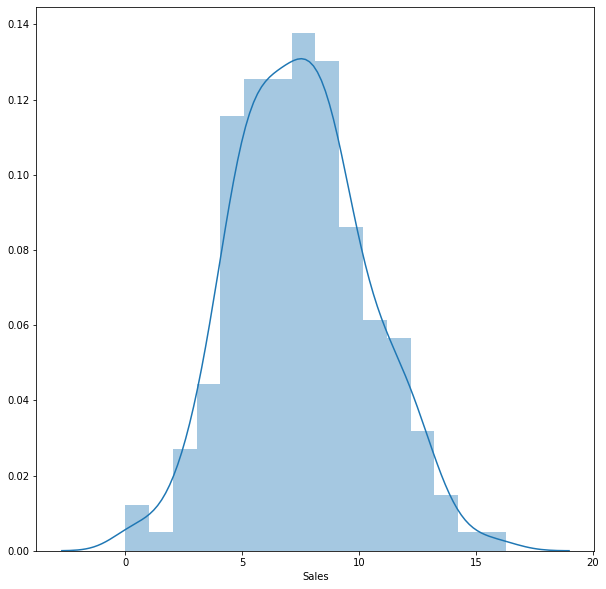

In [7]:
sns.distplot(car.Sales)

In [8]:
car['high'] = [1 if i > 8 else 0 for i in car['Sales']]

In [60]:
feature_names = car.columns

In [61]:
dt_clf = tree.DecisionTreeClassifier()
dt_clf.fit(car[feature_names[1:-1]], car['high'])

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [63]:
tree.export_graphviz(dt_clf, out_file='tree.dot', 
                    feature_names=feature_names[1:-1], 
                    class_names=car['high'].values.astype('str'), 
                    rounded = True, 
                    proportion = True,
                    filled=True,
                    precision=2)

call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])
Image(filename = 'tree.png')

[Text(208.6345588235294, 520.95, 'X[4] <= 92.5\ngini = 0.484\nsamples = 400\nvalue = [236, 164]'),
 Text(50.87647058823529, 475.65000000000003, 'X[0] <= 99.5\ngini = 0.35\nsamples = 62\nvalue = [14, 48]'),
 Text(13.129411764705882, 430.35, 'X[1] <= 61.5\ngini = 0.49\nsamples = 14\nvalue = [6, 8]'),
 Text(6.564705882352941, 385.05, 'gini = 0.0\nsamples = 3\nvalue = [3, 0]'),
 Text(19.694117647058825, 385.05, 'X[4] <= 68.5\ngini = 0.397\nsamples = 11\nvalue = [3, 8]'),
 Text(13.129411764705882, 339.75, 'gini = 0.0\nsamples = 5\nvalue = [0, 5]'),
 Text(26.258823529411764, 339.75, 'X[6] <= 39.0\ngini = 0.5\nsamples = 6\nvalue = [3, 3]'),
 Text(19.694117647058825, 294.45, 'gini = 0.0\nsamples = 2\nvalue = [0, 2]'),
 Text(32.8235294117647, 294.45, 'X[2] <= 11.0\ngini = 0.375\nsamples = 4\nvalue = [3, 1]'),
 Text(26.258823529411764, 249.14999999999998, 'gini = 0.0\nsamples = 3\nvalue = [3, 0]'),
 Text(39.38823529411765, 249.14999999999998, 'gini = 0.0\nsamples = 1\nvalue = [0, 1]'),
 Text(88.

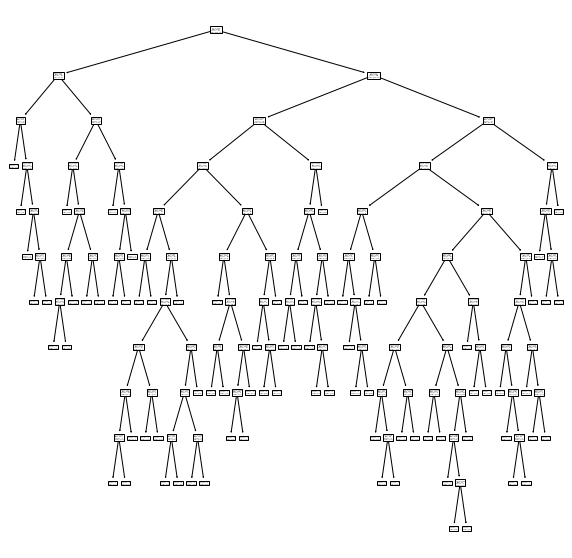

In [65]:
tree.plot_tree(dt_clf.fit(car[feature_names[1:-1]], car['high'])) 

In [70]:
print(tree.export_text(dt_clf, feature_names=list(feature_names[1:-1])))

|--- Price <= 92.50
|   |--- CompPrice <= 99.50
|   |   |--- Income <= 61.50
|   |   |   |--- class: 0
|   |   |--- Income >  61.50
|   |   |   |--- Price <= 68.50
|   |   |   |   |--- class: 1
|   |   |   |--- Price >  68.50
|   |   |   |   |--- Age <= 39.00
|   |   |   |   |   |--- class: 1
|   |   |   |   |--- Age >  39.00
|   |   |   |   |   |--- Advertising <= 11.00
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- Advertising >  11.00
|   |   |   |   |   |   |--- class: 1
|   |--- CompPrice >  99.50
|   |   |--- Age <= 66.50
|   |   |   |--- Income <= 25.50
|   |   |   |   |--- class: 0
|   |   |   |--- Income >  25.50
|   |   |   |   |--- CompPrice <= 139.50
|   |   |   |   |   |--- Population <= 120.00
|   |   |   |   |   |   |--- Population <= 99.50
|   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |--- Population >  99.50
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- Population >  120.00
|   |   |   |   |   |   |--- class: 1
|

In [71]:
X_train, X_test, y_train, y_test = train_test_split(car[feature_names[1:-1]], car['high'], train_size=0.625, random_state=1011)

In [72]:
dt_clf = tree.DecisionTreeClassifier()
dt_clf.fit(X_train.values, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

[Text(286.22159090909093, 518.8909090909091, 'X[2] <= 7.5\ngini = 0.492\nsamples = 250\nvalue = [141, 109]'),
 Text(132.8068181818182, 469.4727272727273, 'X[4] <= 92.0\ngini = 0.411\nsamples = 135\nvalue = [96, 39]'),
 Text(45.09090909090909, 420.05454545454546, 'X[0] <= 109.0\ngini = 0.408\nsamples = 21\nvalue = [6, 15]'),
 Text(22.545454545454547, 370.6363636363636, 'X[4] <= 59.0\ngini = 0.5\nsamples = 10\nvalue = [5, 5]'),
 Text(11.272727272727273, 321.21818181818185, 'gini = 0.0\nsamples = 3\nvalue = [0, 3]'),
 Text(33.81818181818182, 321.21818181818185, 'X[1] <= 72.5\ngini = 0.408\nsamples = 7\nvalue = [5, 2]'),
 Text(22.545454545454547, 271.8, 'gini = 0.0\nsamples = 4\nvalue = [4, 0]'),
 Text(45.09090909090909, 271.8, 'X[7] <= 15.5\ngini = 0.444\nsamples = 3\nvalue = [1, 2]'),
 Text(33.81818181818182, 222.38181818181818, 'gini = 0.0\nsamples = 2\nvalue = [0, 2]'),
 Text(56.36363636363637, 222.38181818181818, 'gini = 0.0\nsamples = 1\nvalue = [1, 0]'),
 Text(67.63636363636364, 370

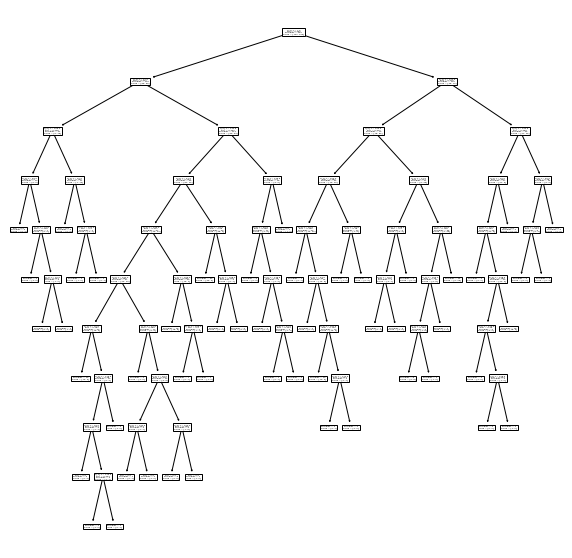

In [73]:
tree.plot_tree(dt_clf) 

In [74]:
y_hat = dt_clf.predict(X_test.values)

In [75]:
pd.DataFrame(confusion_matrix(y_test, y_hat).T, columns=["Low","High"], index=["Low","High"])

,Low,High
Low,71,24
High,24,31


In [76]:
(71+31)/150

0.68

### Pruning

following: https://scikit-learn.org/stable/auto_examples/tree/plot_cost_complexity_pruning.html

In [78]:
dt_clf = tree.DecisionTreeClassifier(random_state=0)

path = dt_clf.cost_complexity_pruning_path(X_train, y_train)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

Text(0.5, 1.0, 'Total Impurity vs effective alpha for training set')

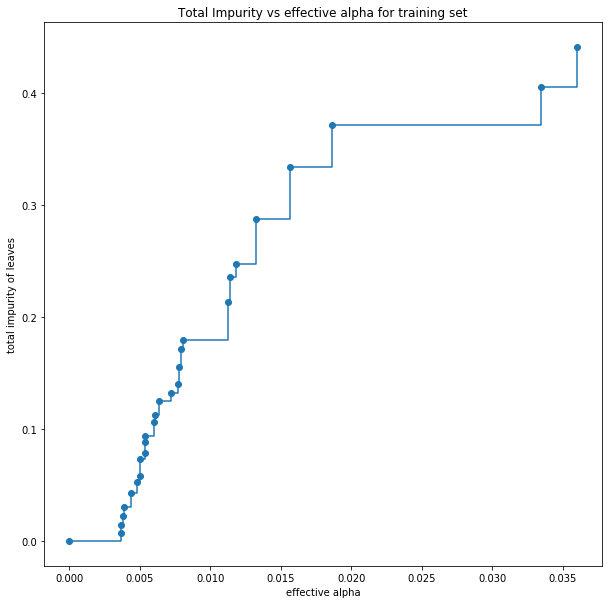

In [79]:
fig, ax = plt.subplots()
ax.plot(ccp_alphas[:-1], impurities[:-1], marker='o', drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set")

In [81]:
clfs = []
for ccp_alpha in ccp_alphas:
    clf = tree.DecisionTreeClassifier(random_state=0, ccp_alpha=ccp_alpha)
    clf.fit(X_train, y_train)
    clfs.append(clf)
print("Number of nodes in the last tree is: {} with ccp_alpha: {}".format(
      clfs[-1].tree_.node_count, ccp_alphas[-1]))

Number of nodes in the last tree is: 1 with ccp_alpha: 0.050810898550724626


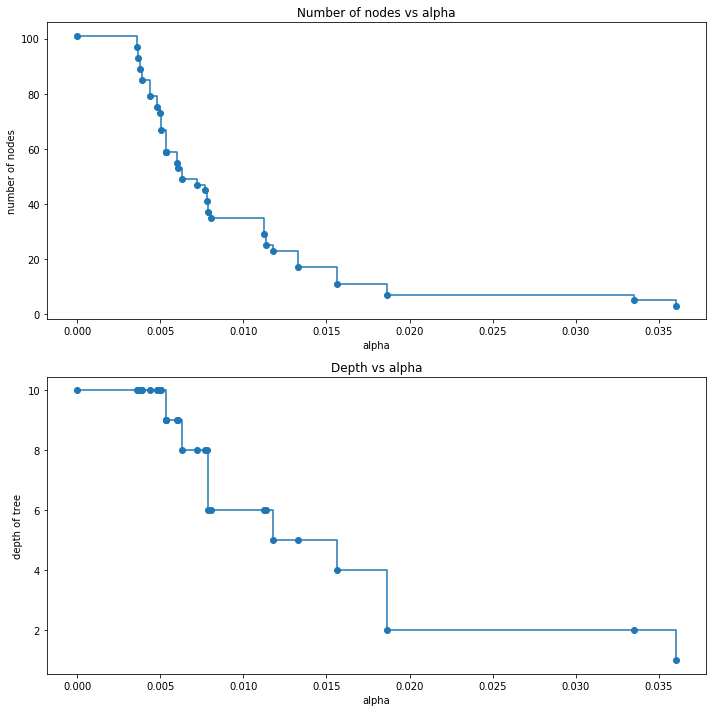

In [82]:
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]

node_counts = [clf.tree_.node_count for clf in clfs]
depth = [clf.tree_.max_depth for clf in clfs]
fig, ax = plt.subplots(2, 1)
ax[0].plot(ccp_alphas, node_counts, marker='o', drawstyle="steps-post")
ax[0].set_xlabel("alpha")
ax[0].set_ylabel("number of nodes")
ax[0].set_title("Number of nodes vs alpha")
ax[1].plot(ccp_alphas, depth, marker='o', drawstyle="steps-post")
ax[1].set_xlabel("alpha")
ax[1].set_ylabel("depth of tree")
ax[1].set_title("Depth vs alpha")
fig.tight_layout()

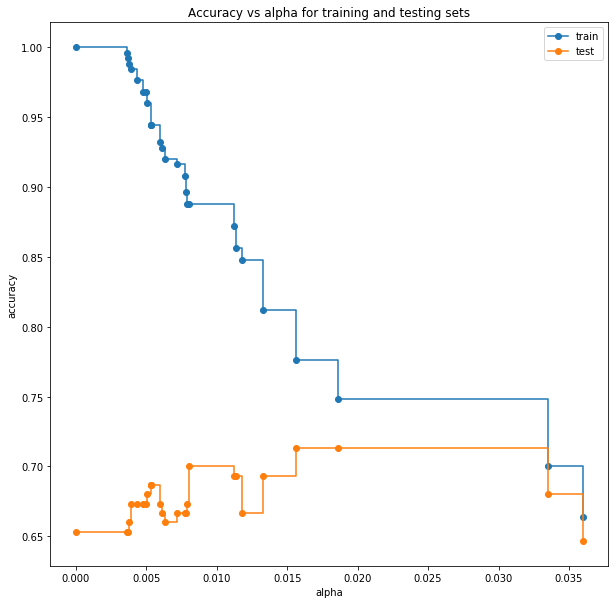

In [84]:
train_scores = [clf.score(X_train, y_train) for clf in clfs]
test_scores = [clf.score(X_test, y_test) for clf in clfs]

fig, ax = plt.subplots()
ax.set_xlabel("alpha")
ax.set_ylabel("accuracy")
ax.set_title("Accuracy vs alpha for training and testing sets")
ax.plot(ccp_alphas, train_scores, marker='o', label="train",
        drawstyle="steps-post")
ax.plot(ccp_alphas, test_scores, marker='o', label="test",
        drawstyle="steps-post")
ax.legend()
plt.show()

In [95]:
y_hat = clfs[-3].predict(X_test)
pd.DataFrame(confusion_matrix(y_test, y_hat).T, columns=["Low","High"], index=["Low","High"])

,Low,High
Low,78,26
High,17,29


In [96]:
(78+29)/150

0.7133333333333334

[Text(279.0, 453.0, 'Advertising <= 7.5\ngini = 0.492\nsamples = 250\nvalue = [141, 109]'),
 Text(139.5, 271.8, 'Price <= 92.0\ngini = 0.411\nsamples = 135\nvalue = [96, 39]'),
 Text(69.75, 90.59999999999997, 'gini = 0.408\nsamples = 21\nvalue = [6, 15]'),
 Text(209.25, 90.59999999999997, 'gini = 0.332\nsamples = 114\nvalue = [90, 24]'),
 Text(418.5, 271.8, 'Price <= 124.5\ngini = 0.476\nsamples = 115\nvalue = [45, 70]'),
 Text(348.75, 90.59999999999997, 'gini = 0.372\nsamples = 73\nvalue = [18, 55]'),
 Text(488.25, 90.59999999999997, 'gini = 0.459\nsamples = 42\nvalue = [27, 15]')]

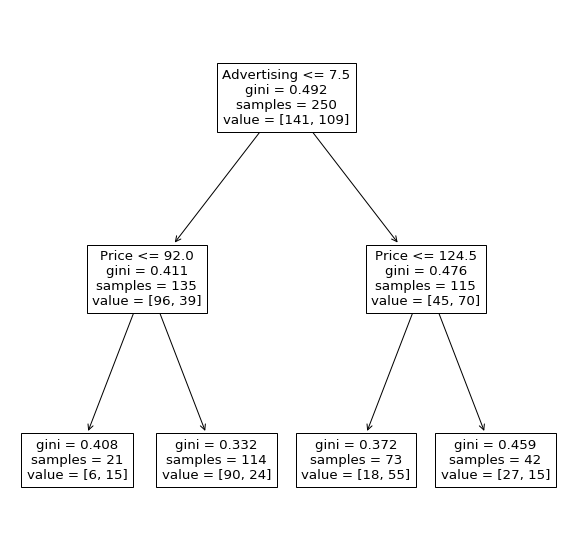

In [98]:
tree.plot_tree(clfs[-3], feature_names=feature_names[1:-1]) 

Pruning increased the accuracy and also returns a smaller tree. 

### Random Forests and Boosting

In [99]:
boston = pd.read_csv('data/Boston.csv')

In [104]:
X_train, X_test = train_test_split(boston, train_size=0.625, random_state=1011)

In [106]:
feature_names = boston.columns

In [116]:
len(feature_names)

3.7416573867739413

In [151]:
rf_clf = RandomForestRegressor(n_estimators= 400, max_features=4, bootstrap=True, oob_score=True, random_state=0)

rf_clf.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features=4, max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=400, n_jobs=None, oob_score=True,
                      random_state=0, verbose=0, warm_start=False)

In [152]:
print(f"Mean of squared error: {np.mean(rf_clf.oob_prediction_)}")
print(f"observed variance: {np.var(rf_clf.oob_prediction_)}")

Mean of squared error: 22.531918330640423
observed variance: 62.45826007711795


In [153]:
y_hat = rf_clf.predict(X_test[feature_names[:-1]])
mean_squared_error(X_test[feature_names[-1]], y_hat)

15.599751677960514

In [156]:
oob_mse = []
test_mse = []

for i in range(1, len(feature_names[:-1])+ 1):
    
    rf_clf = RandomForestRegressor(n_estimators= 400, max_features=i, oob_score=True, random_state=0)
    rf_clf.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])

    oob_mse.append(np.mean(rf_clf.oob_prediction_))
    
    y_hat = rf_clf.predict(X_test[feature_names[:-1]])
    mse = mean_squared_error(X_test[feature_names[-1]], y_hat)
    test_mse.append(mse)

[Text(0, 0.5, 'MSE'), Text(0.5, 0, 'Tree size')]

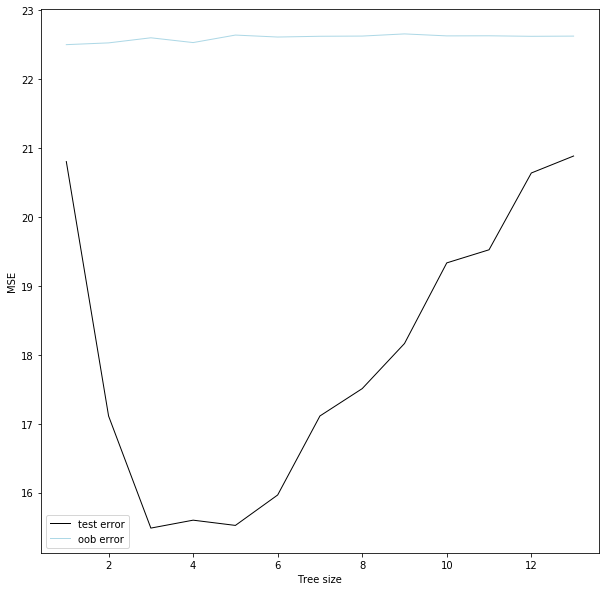

In [157]:
ax = sns.lineplot(range(1, len(feature_names[:-1])+ 1), test_mse, color='black', legend='brief', label='test error', lw=1)
sns.lineplot(range(1, len(feature_names[:-1])+ 1), oob_mse, color='lightblue', legend='brief', label='oob error', lw=1)
ax.set(xlabel='Tree size', ylabel='MSE')

This looks a bit weird, since the test error is below the out of the bag error. Also the test error increases with the tree size, which is also a bit strange. It looks a bit like overfitting at a tree size of 6, although there is no incident of overfitting in the out of the bag error.

### Boosting

In [217]:
xgb_reg = xgb.XGBRegressor(max_depth=4, n_estimators=1000, objective="reg:squarederror", gamma=0.1, random_state=42)
xgb_reg.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0.1,
             importance_type='gain', learning_rate=0.1, max_delta_step=0,
             max_depth=4, min_child_weight=1, missing=None, n_estimators=1000,
             n_jobs=1, nthread=None, objective='reg:squarederror',
             random_state=42, reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
             seed=None, silent=None, subsample=1, verbosity=1)

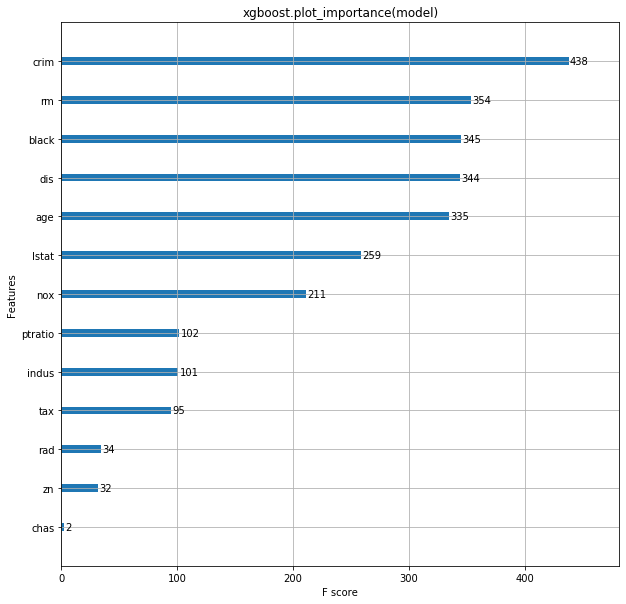

In [218]:
xgb.plot_importance(xgb_reg)
plt.title("xgboost.plot_importance(model)")
plt.show()

sklearn partial dependence plot throws an error, so i try to use pdp. 

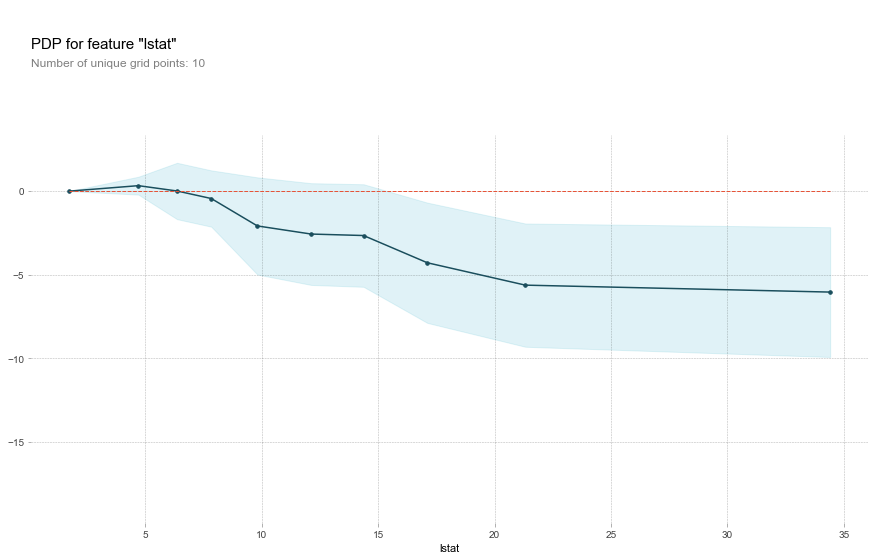

In [219]:
pdp_dist = pdp.pdp_isolate(model=xgb_reg, dataset=X_train[feature_names[:-1]], 
                           model_features=feature_names[:-1], feature="lstat")

pdp.pdp_plot(pdp_dist, "lstat")
plt.show()

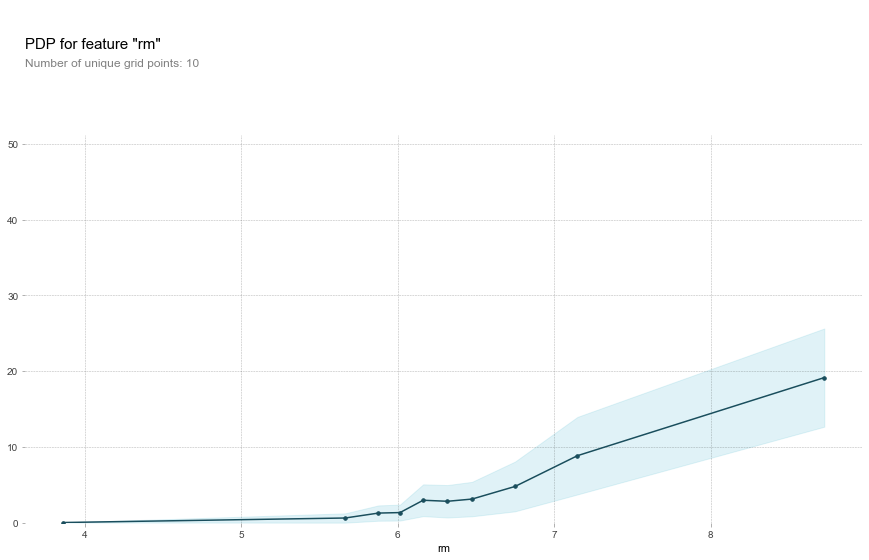

In [220]:
pdp_dist = pdp.pdp_isolate(model=xgb_reg, dataset=X_train[feature_names[:-1]], 
                           model_features=feature_names[:-1], feature="rm")

pdp.pdp_plot(pdp_dist, "rm")
plt.show()

GradientBoostingRegressor without regularization

In [188]:
gbr_reg = GradientBoostingRegressor(max_depth=4, n_estimators=10000, random_state=42)
gbr_reg.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])

GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=4,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=10000,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=42, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

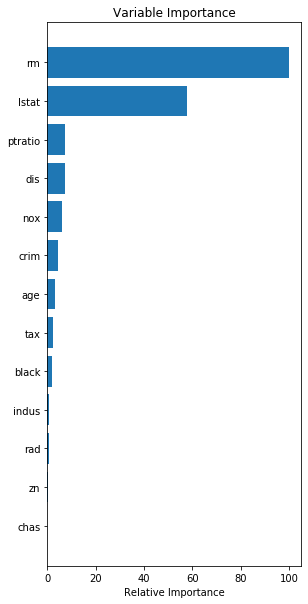

In [196]:
feature_importance = gbr_reg.feature_importances_
# make importances relative to max importance
feature_importance = 100.0 * (feature_importance / feature_importance.max())
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
plt.subplot(1, 2, 2)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, feature_names[:-1][sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Variable Importance')
plt.show()

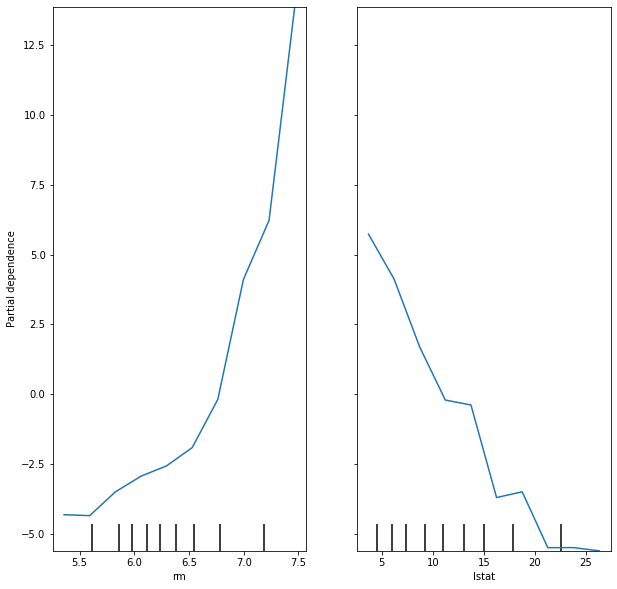

In [195]:
plot_partial_dependence(gbr_reg,       
                       features=[5, 12], # column numbers of plots we want to show
                       X=X_train[feature_names[:-1]],            # raw predictors data.
                       feature_names=feature_names[:-1], # labels on graphs
                       grid_resolution=10) # number of values to plot on x axis

find best number of trees

In [211]:
test_mse = []

for n_tree in range(10, 1000, 20):
    
    gbr_reg = GradientBoostingRegressor(max_depth=4, n_estimators=n_tree, random_state=42)
    gbr_reg.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])
    
    y_hat = gbr_reg.predict(X_test[feature_names[:-1]])
    mse = mean_squared_error(X_test[feature_names[-1]], y_hat)
    
    test_mse.append(mse)

[Text(0, 0.5, 'MSE'), Text(0.5, 0, 'n trees')]

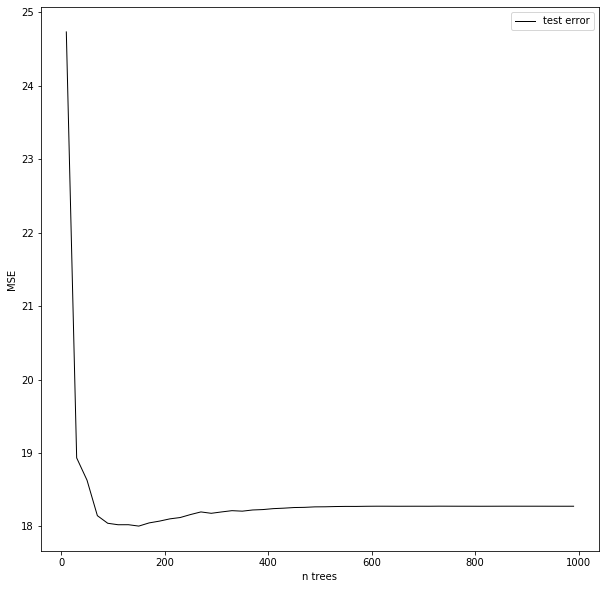

In [214]:
ax = sns.lineplot(range(10, 1000, 20), test_mse, color='black', legend='brief', label='test error', lw=1)
ax.set(xlabel='n trees', ylabel='MSE')

out of curiosity, the same with a stump

In [215]:
test_mse = []

for n_tree in range(10, 1000, 20):
    
    gbr_reg = GradientBoostingRegressor(max_depth=1, n_estimators=n_tree, random_state=42)
    gbr_reg.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])
    
    y_hat = gbr_reg.predict(X_test[feature_names[:-1]])
    mse = mean_squared_error(X_test[feature_names[-1]], y_hat)
    
    test_mse.append(mse)

[Text(0, 0.5, 'MSE'), Text(0.5, 0, 'n trees')]

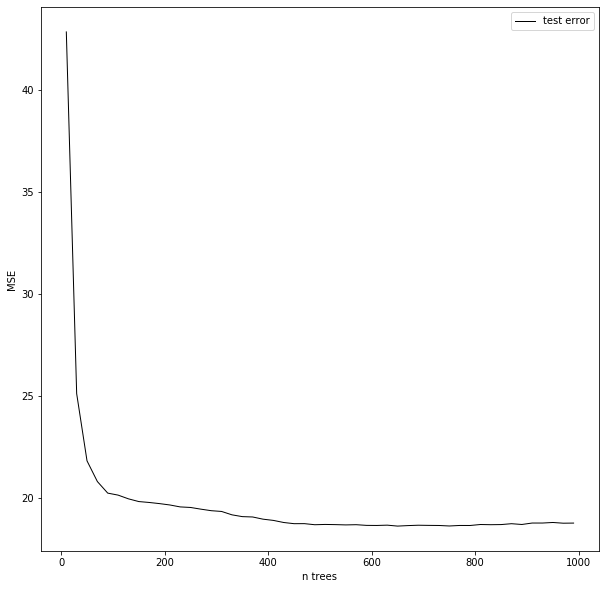

In [216]:
ax = sns.lineplot(range(10, 1000, 20), test_mse, color='black', legend='brief', label='test error', lw=1)
ax.set(xlabel='n trees', ylabel='MSE')

and with xgboost

In [223]:
test_mse = []

for n_tree in range(10, 1000, 20):
    
    xgb_reg = xgb.XGBRegressor(max_depth=4, n_estimators=n_tree, objective="reg:squarederror", gamma=0.1, random_state=42)
    xgb_reg.fit(X_train[feature_names[:-1]], X_train[feature_names[-1]])
    
    y_hat = xgb_reg.predict(X_test[feature_names[:-1]])
    mse = mean_squared_error(X_test[feature_names[-1]], y_hat)
    
    test_mse.append(mse)

[Text(0, 0.5, 'MSE'), Text(0.5, 0, 'n trees')]

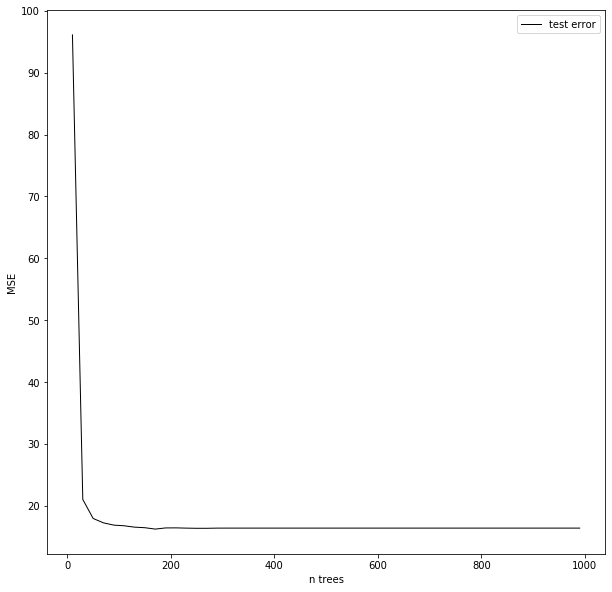

In [224]:
ax = sns.lineplot(range(10, 1000, 20), test_mse, color='black', legend='brief', label='test error', lw=1)
ax.set(xlabel='n trees', ylabel='MSE')